#### Topic modeling on job descriptions in resumes
In this notebook, I preproocess text in job descriptions, vectoriz text, and run nmf topic modeling. Topic model represents each document (job description in my case) as weighted sum of topics. It is therefore possible to represent each job description as a topic weight matrix/vector. Topic model represents each topic as a mixture of words that frequently occur in the topic. These words can be used to infer what each topic is. In my case, topics can be considered skills that are important for a job. 

In [1]:
import warnings
warnings.filterwarnings('ignore')
import pandas as pd
import numpy as np
import random
import pickle
import os
import re
from nltk.corpus import stopwords
from nltk.tokenize import RegexpTokenizer
from nltk.stem.wordnet import WordNetLemmatizer
from collections import Counter
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.decomposition import NMF
from gensim.models import Word2Vec
from itertools import combinations 
from sklearn.manifold import TSNE
from bokeh.plotting import figure, show, output_notebook, save
from bokeh.models import HoverTool, value, LabelSet, Legend, ColumnDataSource

In [2]:
df_work = pd.read_csv('work_exp.csv')

In [3]:
# use job_type as job_title if tile is not available
df_work['job_title'] = df_work.job_title.fillna(df_work.job_type)

In [4]:
df_work.head()

,resume_id,job_type,job_id,job_title,job_duration,job_description,lang
0,1,data+scientist,0,Data Scientist,February 2013 to Present,"2016 ~ Manager, Smart Solution Team in Informa...",en
1,1,data+scientist,1,Business Inteligence Consultant,January 2006 to February 2013,2011 Social Media Analysis- Participate in the...,en
2,2,data+scientist,0,Director of Business Relations,May 2018 to Present,GIMME360 Data Scientist-Business Solution 20...,en
3,2,data+scientist,1,Senior Data Analyst-Customer Interaction Decis...,May 2014 to July 2016,SAS Fulltime• Translated business objectives ...,en
4,3,data+scientist,0,FREELANCE DEVELOPER,March 2016 to Present,"Toronto, Canada• Completed 30+ freelancer Proj...",en


#### preprocess text columns

In [5]:
def preprocess(text):
    """ preprocess text: remove special characters, remove digits, tokenize,
    lowercase, remove stopwords, lemmatize
    """
    # preparing for text preprocessing: tokenizer, stopwords, and lemmatizer
    tokenizer = RegexpTokenizer(r'\w+')
    stopwords_en = set(stopwords.words('english'))
    lemmatizer = WordNetLemmatizer()
    
    text = re.sub('[^a-zA-Z]', ' ', text )
    text = re.sub(r'\s+', ' ', text)
    tokens = tokenizer.tokenize(text)
    tokens = [token.lower() for token in tokens if len(token)>1]
    tokens = [lemmatizer.lemmatize(token) for token in tokens if token not in stopwords_en]
    return ' '.join(tokens)

In [6]:
# preprocess job title and description
for col in ['job_title', 'job_description']:
    df_work[col] = df_work[col].astype(str)
    df_work[col+'_processed'] = df_work[col].apply(preprocess)

# have a column for both title and descritpion
cols = ['job_title_processed', 'job_description_processed']
df_work['title_and_desc'] = df_work[cols].apply(lambda x: ' '.join(x), axis=1)

In [7]:
# choose columns needed for subsequent analysis
df_work = df_work[['resume_id', 'job_id', 'job_title_processed', 'job_description_processed', 'title_and_desc']]

In [8]:
df_work.head()

,resume_id,job_id,job_title_processed,job_description_processed,title_and_desc
0,1,0,data scientist,manager smart solution team information planni...,data scientist manager smart solution team inf...
1,1,1,business inteligence consultant,social medium analysis participate development...,business inteligence consultant social medium ...
2,2,0,director business relation,gimme data scientist business solution present...,director business relation gimme data scientis...
3,2,1,senior data analyst customer interaction decis...,sa fulltime translated business objective data...,senior data analyst customer interaction decis...
4,3,0,freelance developer,toronto canada completed freelancer project in...,freelance developer toronto canada completed f...


split data into training and validation sets

In [9]:
df_work['resume_id'].nunique()

2587

In [10]:
# randomly choose 2300 unique resume_id values for training, save the rest for validation
resume_id = df_work['resume_id'].unique()

np.random.seed(0)
resume_id_train = np.random.choice(resume_id, 2300, replace=False)
resume_id_val = [i for i in resume_id if i not in resume_id_train]

df_work_train = df_work[df_work.resume_id.isin(resume_id_train)]
df_work_train.reset_index(drop=True, inplace=True)

df_work_val = df_work[df_work.resume_id.isin(resume_id_val)]
df_work_val.reset_index(drop=True, inplace=True)

In [30]:
# pickle df_work_val for later use
with open('work_exp_validation.pkl','wb') as f:
    pickle.dump(df_work_val, f)

have a preliminary look at common words in titles and descriptions

In [11]:
def plot_common_words(df, column, n):
    """plot n most common words in a column of a df"""
    fdist = Counter(' '.join(row for row in df[column]).split()).most_common(n) # freq distribution of n most common words
    word = [i[0] for i in fdist]
    count = [i[1] for i in fdist]
    word_pos = [i for i, _ in enumerate(word)]
    
    plt.figure(figsize=(8, 6))
    plt.barh(word_pos, count)
    plt.yticks(word_pos, word)
    plt.ylabel('word')
    plt.xlabel('count')
    plt.title('Frequency of'+' '+str(n)+' '+'most common words in {}'.format(column))
    plt.gca().invert_yaxis() # invert y axis to descending order
    plt.show()

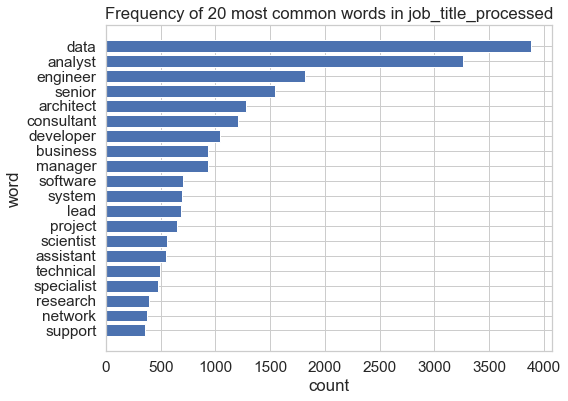

In [12]:
# plot most common words in job titles
sns.set(style='whitegrid', font_scale=1.4)
plot_common_words(df_work_train, 'job_title_processed', 20) 

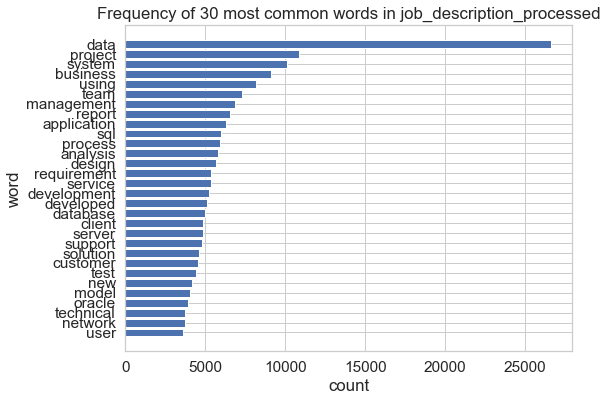

In [13]:
plot_common_words(df_work_train, 'job_description_processed', 30)

#### topic modeling with all job descriptions in training data
I ran nmf topic models with a range of k, or number of topics. To decide which k to use, I computed mean coherence score for top words in different topics, that is, the extent to which top words within particular topics are semantically related. K that gives highest mean coherence score is used. 

In [14]:
# vectorize job description - for work_exp df
vectorizer = TfidfVectorizer(max_df=0.95, min_df=2, max_features=5000)
job_description_vec = vectorizer.fit_transform(df_work_train.job_description_processed) 

In [15]:
def multiple_nmf(kmin, kmax, vec_text):
    """run multiple nmf models with a chosen range of number of components,
    return a list XXXXX
    
    kmin -- minimum number of topics
    kmax -- maximum number of topics
    vec_text -- vectorized text
    """
    topic_models = []
    for k in range(kmin, kmax+1):
        print("Applying NMF for k=%d ..." % k)
        nmf = NMF(n_components=k,
                  init="nndsvd",
                  alpha=0.1,
                  random_state=42) 
        W = nmf.fit_transform(vec_text)
        H = nmf.components_    
        topic_models.append((k, nmf, W, H))
    
    return topic_models

In [16]:
topic_models = multiple_nmf(10, 20, job_description_vec)

Applying NMF for k=10 ...
Applying NMF for k=11 ...
Applying NMF for k=12 ...
Applying NMF for k=13 ...
Applying NMF for k=14 ...
Applying NMF for k=15 ...
Applying NMF for k=16 ...
Applying NMF for k=17 ...
Applying NMF for k=18 ...
Applying NMF for k=19 ...
Applying NMF for k=20 ...


train a word2vec using job descriptions to get semantic similarity of words in this dataset, which can then be used to compute topic coherence of different nmf models

In [17]:
# convert job_description_processed to a list of lists for word2vec model
job_desc_train = df_work_train['job_description_processed'].apply(lambda x: x.split(' ')).tolist()

# train word2vec model
word2vec_model = Word2Vec(job_desc_train,
                          size=200,
                          window=8,
                          min_count=5,
                          workers=4)
word2vec_model.train(job_desc_train, total_examples=len(job_desc_train), epochs=10)

(9233846, 10563540)

In [18]:
# have a look at the word2vec results
word2vec_model.wv.most_similar(positive='python')

[('panda', 0.7463384866714478),
 ('numpy', 0.7169931530952454),
 ('pyspark', 0.6822658777236938),
 ('matplotlib', 0.673590362071991),
 ('jupyter', 0.6703145503997803),
 ('notebook', 0.6604925394058228),
 ('nltk', 0.6514522433280945),
 ('seaborn', 0.644631028175354),
 ('weka', 0.6391153931617737),
 ('scikit', 0.6334868669509888)]

In [19]:
word2vec_model.wv.similarity('learning', 'python')

0.34775007

functions to compute and compare coherence between nmf models

In [20]:
def get_top_terms(vectorizer, H, n_top_terms):
    """get terms most important for each of the topics of an nmf model
    return a dictionary with topic number as key and a list of top terms as values
    
    vectorizer -- vectorizer for text
    H -- topic term matrix from nmf model
    n_top_terms -- number of top words to choose
    """
    terms = vectorizer.get_feature_names()
    
    top_terms_dict = {};
    # for each topic, get the largest weights, and save the corresponding words into the dictionary
    num_topics = H.shape[0]
    for i in range(num_topics):
        ids = H[i].argsort()[-n_top_terms:] 
        # word_ids is ordered such that largest weight is the last item, reverse it to have it as first item
        top_terms_dict['Topic '+'{:01d}'.format(i+1)] = [terms[id] for id in reversed(ids)]
        
    return top_terms_dict

In [21]:
def compute_coherence(word2vec_model, top_terms_dict):
    """compute coherence score, ie, mean pairwise similarity of top terms
    
    word2vec_model -- word2vec model trained on words in dataset
    top_term_dict -- top words of each topic (output of get_top_terms() function)
    """
    overall_coherence = 0.0
    num_topics = len(top_terms_dict)
    for i in range(num_topics):
        pair_scores = []
        # compute similarity score for each pair of top words in each topic
        for pair in combinations(top_terms_dict['Topic '+'{:01d}'.format(i+1)], 2):
            pair_scores.append(word2vec_model.wv.similarity(pair[0], pair[1]))
        
        topic_score = sum(pair_scores)/len(pair_scores)
        overall_coherence += topic_score
    
    # get mean score across topics
    return overall_coherence/num_topics

In [22]:
def compare_coherence(topic_models, vectorizer, n_top_terms, word2vec_model):
    """get topic coherence for multiple nmf models
    
    topic_models -- output of multiple_nmf() function
    """
    coherence_dict = {}
    for i in range(len(topic_models)):
        top_terms_dict = get_top_terms(vectorizer, topic_models[i][3], n_top_terms) # 4th element of each list in topic_models: H     
        
        k = topic_models[i][0] # first element of each list in topic models: k
        coherence = compute_coherence(word2vec_model, top_terms_dict)
        print("K=%02d: Coherence=%.4f" % (k, coherence))
        coherence_dict[k] = coherence
        
    return coherence_dict    

In [23]:
coherence_dict = compare_coherence(topic_models, vectorizer, 20, word2vec_model)

K=10: Coherence=0.1898
K=11: Coherence=0.1895
K=12: Coherence=0.1896
K=13: Coherence=0.2041
K=14: Coherence=0.2001
K=15: Coherence=0.2011
K=16: Coherence=0.2081
K=17: Coherence=0.2055
K=18: Coherence=0.2098
K=19: Coherence=0.2107
K=20: Coherence=0.2238


the nmf model with 20 topics has highest topic coherence. So k=20 will be used for subsequent analyses.

In [24]:
# get top words for each of 20 topics
best_k = 20
top_words = pd.DataFrame(get_top_terms(vectorizer, topic_models[best_k-10][3], 15))
W = topic_models[best_k-10][2]

In [25]:
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

have a look at top words, or words that occur most frequently in each of the 20 topics. topics are then inferred based on these top words.

In [26]:
# have a look at top words in each of the 20 topics
top_words

,Topic 1,Topic 2,Topic 3,Topic 4,Topic 5,Topic 6,Topic 7,Topic 8,Topic 9,Topic 10,Topic 11,Topic 12,Topic 13,Topic 14,Topic 15,Topic 16,Topic 17,Topic 18,Topic 19,Topic 20
0,data,process,application,network,analysis,test,learning,customer,business,project,system,architecture,software,hadoop,product,report,student,oracle,server,client
1,warehouse,ensure,web,cisco,sa,testing,model,service,requirement,team,management,enterprise,hardware,using,sale,cognos,course,pl,sql,need
2,source,quality,developed,switch,excel,case,machine,support,process,managed,designed,solution,computer,spark,marketing,bi,university,sql,database,financial
3,etl,work,net,router,statistical,defect,algorithm,call,solution,plan,information,management,support,hive,company,reporting,school,database,microsoft,team
4,model,daily,java,ip,financial,plan,python,issue,functional,management,implementation,technology,development,big,market,dashboard,computer,unix,ssis,solution
5,quality,production,designed,configuration,using,script,using,satisfaction,document,manager,developed,service,technical,python,campaign,created,teaching,informatica,ssrs,account
6,mapping,operation,javascript,wan,data,functional,deep,provided,user,budget,new,design,user,cluster,team,query,research,db,net,service
7,database,control,html,lan,risk,quality,technique,order,design,resource,implemented,security,problem,hdfs,new,developed,lab,etl,window,provided
8,mart,management,using,infrastructure,research,regression,feature,provide,technical,delivery,cobol,development,window,scala,strategy,user,taught,shell,procedure,various
9,master,team,asp,support,performed,automated,image,need,case,planning,user,strategy,installation,sqoop,revenue,using,science,environment,visual,relationship


inferred topics:
<br>Topic 1: data warehouse, Topic 2: project management, Topic 3: web development, Topic 4: network development,
<br>Topic 5: statistical analysis, Topic 6: product testing, Topic 7: machine learning, Topic 8: customer support,
<br>Topic 9: business solutions, Topic 10: management/leadership, Topic 11: systems management, Topic 12: enterprise data architecture,
<br>Topic 13: IT technical support, Topic 14: big data tools, Topic 15: marketing, Topic 16: data analytics and reporting,
<br>Topic 17: academic research, Topic 18: database management, Topic 19: SQL server tools, Topic 20: client relationship

In [34]:
# have a df for document topic matrix, merge with df_work
W = topic_models[best_k-10][2]

topic_weights = pd.DataFrame(W, columns=['Topic '+'{:01d}'.format(i+1) for i in range(best_k)])
topic_weights1 = pd.DataFrame.copy(topic_weights)
# normalize topic weights such that they sum to 1 for each ducoment/job description
topic_weights1 = topic_weights1.div(topic_weights1.sum(axis=1), axis=0)

# find top 3 topics for each document/job description
topic_weights1['highest_topic1'] = topic_weights.idxmax(axis=1)
topic_weights1['highest_topic2'] = topic_weights.T.apply(lambda x: x.nlargest(2).idxmin())
topic_weights1['highest_topic3'] = topic_weights.T.apply(lambda x: x.nlargest(3).idxmin())

df_work_train = pd.concat([df_work_train, topic_weights1], axis=1, sort=False)

In [35]:
df_work_train.head()

,resume_id,job_id,job_title_processed,job_description_processed,title_and_desc,Topic 1,Topic 2,Topic 3,Topic 4,Topic 5,Topic 6,Topic 7,Topic 8,Topic 9,Topic 10,Topic 11,Topic 12,Topic 13,Topic 14,Topic 15,Topic 16,Topic 17,Topic 18,Topic 19,Topic 20,highest_topic1,highest_topic2,highest_topic3
0,1,0,data scientist,manager smart solution team information planni...,data scientist manager smart solution team inf...,0.374065,0.000000,0.000000,0.000000,0.025764,0.000000,0.086130,0.000000,0.000000,0.041831,0.000000,0.060487,0.0,0.258667,0.030413,0.000000,0.122643,0.0,0.0,0.000000,Topic 1,Topic 14,Topic 17
1,1,1,business inteligence consultant,social medium analysis participate development...,business inteligence consultant social medium ...,0.000000,0.000000,0.094456,0.000000,0.283788,0.000000,0.019943,0.000000,0.106125,0.000000,0.121584,0.062855,0.0,0.000000,0.124647,0.182327,0.004276,0.0,0.0,0.000000,Topic 5,Topic 16,Topic 15
2,2,0,director business relation,gimme data scientist business solution present...,director business relation gimme data scientis...,0.043636,0.000000,0.000000,0.000000,0.406016,0.002058,0.093207,0.240388,0.050646,0.000000,0.000000,0.000000,0.0,0.009227,0.154823,0.000000,0.000000,0.0,0.0,0.000000,Topic 5,Topic 8,Topic 15
3,2,1,senior data analyst customer interaction decis...,sa fulltime translated business objective data...,senior data analyst customer interaction decis...,0.010189,0.066499,0.004399,0.042836,0.210310,0.036869,0.356958,0.074922,0.055022,0.013159,0.000000,0.000000,0.0,0.000000,0.103456,0.015330,0.010051,0.0,0.0,0.000000,Topic 7,Topic 5,Topic 15
4,3,0,freelance developer,toronto canada completed freelancer project in...,freelance developer toronto canada completed f...,0.000000,0.000000,0.462758,0.000000,0.000000,0.000000,0.267470,0.000000,0.000000,0.122256,0.020006,0.002502,0.0,0.000000,0.057464,0.028745,0.038407,0.0,0.0,0.000393,Topic 3,Topic 7,Topic 10


In [36]:
# pickle df_work_train, best nmf model, vectorizer
with open('work_exp_train.pkl','wb') as f:
    pickle.dump(df_work_train, f)
with open('vectorizer.pkl','wb') as f:
    pickle.dump(vectorizer, f)
with open('nmf.pkl','wb') as f:
    pickle.dump(topic_models[-1][1], f)

t-sne visualization of topics

In [189]:
output_notebook()

Loading BokehJS ...

In [193]:
# reduce 25-d to 2-d for visualization of topics
# tsne with 2 components
tsne = TSNE(n_components=2, random_state=42)
tsne_nmf = tsne.fit_transform(W_norm)

In [194]:
df_work_train['tsne1'] = tsne_nmf[:, 0]
df_work_train['tsne2'] = tsne_nmf[:, 1]

# summary of highest topic: use top 5 words from each topic (each column in nmf_topics df)
df_work_train['topic_sum'] = df_work_train.highest_topic1.apply(lambda x: x + ': ' + ', '.join(top_words.loc[:, x][:5]))

In [195]:
# color mapping for most important topic
topics = ['Topic '+'{:01d}'.format(i+1) for i in range(20)]
colors = ['#ffcc33', '#ff9999', '#ff3333', '#ff9900', '#cc99cc',
          '#996600', '#cc6666', '#cc0033', '#99ccff', '#660066',
          '#336600', '#003366', '#ffff00', '#ccff00', '#999999',
          '#93cbbd', '#0000cc', '#9966cc', '#3399cc', '#ffccff']
color_dict = dict(zip(topics, colors))
df_work_train['color'] = df_work_train.highest_topic1.apply(lambda x: color_dict[x])

In [196]:
# change psych df to bokeh data structure
source = ColumnDataSource(df_work_train)

title = 'T-SNE visualization of topics in descriptions of work experience'

plot_nmf = figure(plot_width=1000, plot_height=800, title=title,
                  tools="pan,wheel_zoom,box_zoom,reset,hover,previewsave",
                  x_axis_type=None, y_axis_type=None, min_border=1)

plot_nmf.scatter(x='tsne1', y='tsne2', source=source,
                 color='color', alpha=0.6, size=4)

# for i in range(norm_features.shape[1]):
#     plot_nmf.text(topic_coord[i, 0], topic_coord[i, 1], [we['topic_sum'][i]])

# hover tools - display title, agency of each job post
hover = plot_nmf.select(dict(type=HoverTool))
hover.tooltips = {"Work experience": "Title: @job_title_processed"}

show(plot_nmf)